In [94]:
# !pip install GDAL-3.1.4-cp39-cp39m-win_amd64.whl
# !pip install Fiona-1.8.17-cp39-cp39m-win_amd64.whl
# !pip install Shapely-1.7.1-cp39-cp39m-win_amd64.whl 
# !pip install geopandas

In [ ]:
# !pip install GDAL
# !pip install Fiona
# !pip install Shapely 
# !pip install geopandas
conda install -c conda-forge geopandas

In [4]:
import numpy as np
import pandas as pd
import geopandas
import matplotlib.pyplot as plt

<AxesSubplot:>

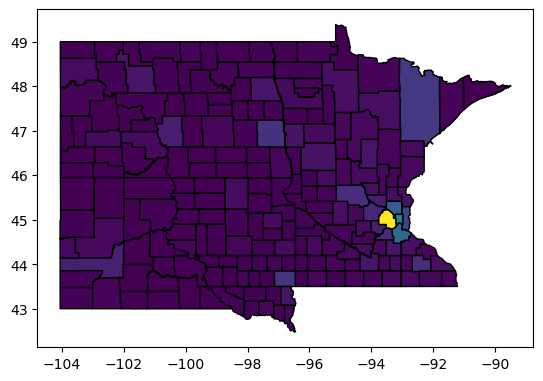

In [27]:
filename = "countiesWithStatesAndPopulation.shp"
index_col = "FIPS"
map_data = geopandas.read_file(filename = filename).set_index(["State", 
                                                               "NAME"])
map_plot_data = map_data.loc[["North Dakota", 
                              "South Dakota", 
                              "Minnesota"]]
map_plot_data.plot(column = "Population", 
                   cmap = "viridis",
                   alpha = 1, 
                   edgecolor = "k")
# map_plot_data.groupby("State").mean().plot(alpha = 1, linewidth = 10)

In [36]:
def import_geo_data(filename, FIPS_name = "FIPS"):
    map_data = geopandas.read_file(filename = filename).rename(
        columns = {"State":"state"})
    map_data[FIPS_name] = map_data["STATEFP"].astype(str) +\
        map_data["COUNTYFP"].astype(str)
    map_data[FIPS_name] = map_data[FIPS_name].astype(np.int64)
    map_data.set_index(FIPS_name, inplace = True)
    
    return map_data
map_data = import_geo_data(filename = filename, FIPS_name = index_col)
map_data

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,NAME,LSAD,ALAND,AWATER,Population,state,geometry
FIPS,,,,,,,,,,,
21007,21,007,00516850,0500000US21007,Ballard,06,639387454,69473325,7888.0,Kentucky,"POLYGON ((-89.18137 37.04630, -89.17938 37.053..."
21017,21,017,00516855,0500000US21017,Bourbon,06,750439351,4829777,19788.0,Kentucky,"POLYGON ((-84.44266 38.28324, -84.44114 38.283..."
21031,21,031,00516862,0500000US21031,Butler,06,1103571974,13943044,12879.0,Kentucky,"POLYGON ((-86.94486 37.07341, -86.94346 37.074..."
21065,21,065,00516879,0500000US21065,Estill,06,655509930,6516335,14106.0,Kentucky,"POLYGON ((-84.12662 37.64540, -84.12483 37.646..."
21069,21,069,00516881,0500000US21069,Fleming,06,902727151,7182793,14581.0,Kentucky,"POLYGON ((-83.98428 38.44549, -83.98246 38.450..."
...,...,...,...,...,...,...,...,...,...,...,...
31073,31,073,00835858,0500000US31073,Gosper,06,1186616237,11831826,1990.0,Nebraska,"POLYGON ((-100.09510 40.43866, -100.08937 40.4..."
39075,39,075,01074050,0500000US39075,Holmes,06,1094405866,3695230,43960.0,Ohio,"POLYGON ((-82.22066 40.66758, -82.19327 40.667..."
48171,48,171,01383871,0500000US48171,Gillespie,06,2740719114,9012764,26988.0,Texas,"POLYGON ((-99.30400 30.49983, -99.28234 30.499..."


<AxesSubplot:>

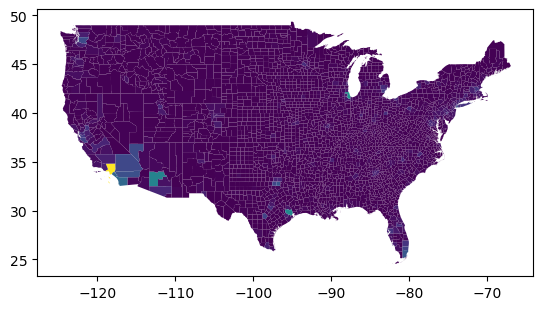

In [41]:
# plot only counties not in Hawaii or Alaska
map_data[~map_data["state"].isin(
    ["Hawaii", "Alaska"])].plot(column = "Population")

In [82]:
u_data = pd.read_csv("countyUnemploymentData.csv",
                    encoding = "latin1",
                    parse_dates = True,
                    index_col = ["date", "fips_code"])
u_data = u_data[list(u_data.keys())[-4:]]
u_data.dtypes

C:\Users\JLCat\AppData\Local\Temp\ipykernel_33604\1701343223.py:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  u_data = pd.read_csv("countyUnemploymentData.csv",


Labor Force          object
Employed             object
Unemployed           object
Unemployment Rate    object
dtype: object

In [83]:
for key in u_data.keys():
    u_data[key] = pd.to_numeric(u_data[key], errors = "coerce")
u_data.dtypes

Labor Force          float64
Employed             float64
Unemployed           float64
Unemployment Rate    float64
dtype: object

In [84]:
import copy as copy
def create_merged_geo_dataframe(data, map_data):
    data_frame_initialized = False
    matching_gpd = {}
    counties = data.groupby("fips_code").mean().index.unique()
    dates = data.groupby("date").mean().index.unique()
    for key, val in data.items():
        matching_gpd[key] = copy.copy(
            map_data[map_data.index.isin(counties)])
        for date in dates:
            val_slice = val.loc[date]
            val_slice.reset_index().set_index("fips_code")
            matching_gpd[key][date] = val_slice
    return matching_gpd
dates = u_data.groupby("date").mean().index.unique()
u_data = create_merged_geo_dataframe(u_data, map_data)

In [85]:
dates

DatetimeIndex(['2019-08-01', '2019-09-01', '2019-10-01', '2019-11-01',
               '2019-12-01', '2020-01-01', '2020-02-01', '2020-03-01',
               '2020-04-01', '2020-05-01', '2020-06-01', '2020-07-01',
               '2020-08-01', '2020-09-01', '2020-10-01', '2020-11-01',
               '2020-12-01', '2021-01-01', '2021-02-01', '2021-03-01',
               '2021-04-01', '2021-05-01', '2021-06-01', '2021-07-01',
               '2021-08-01'],
              dtype='datetime64[ns]', name='date', freq=None)

C:\Users\JLCat\AppData\Local\Temp\ipykernel_33604\1828110678.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize = (40,20))


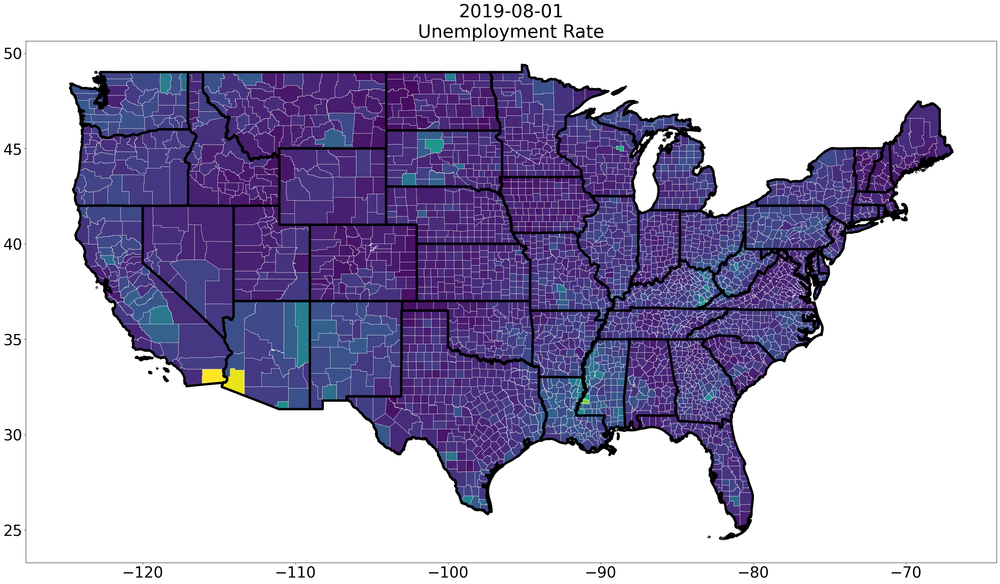

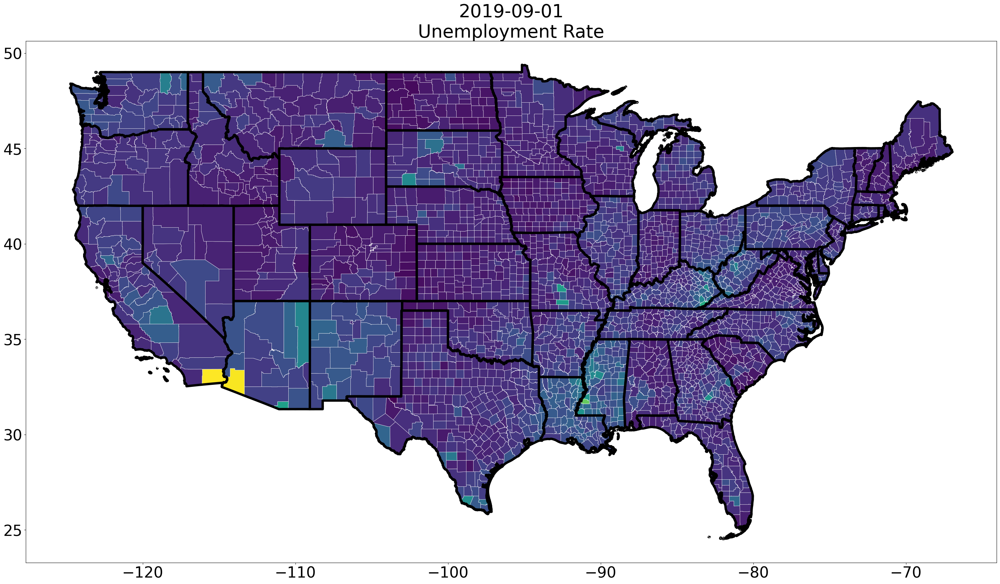

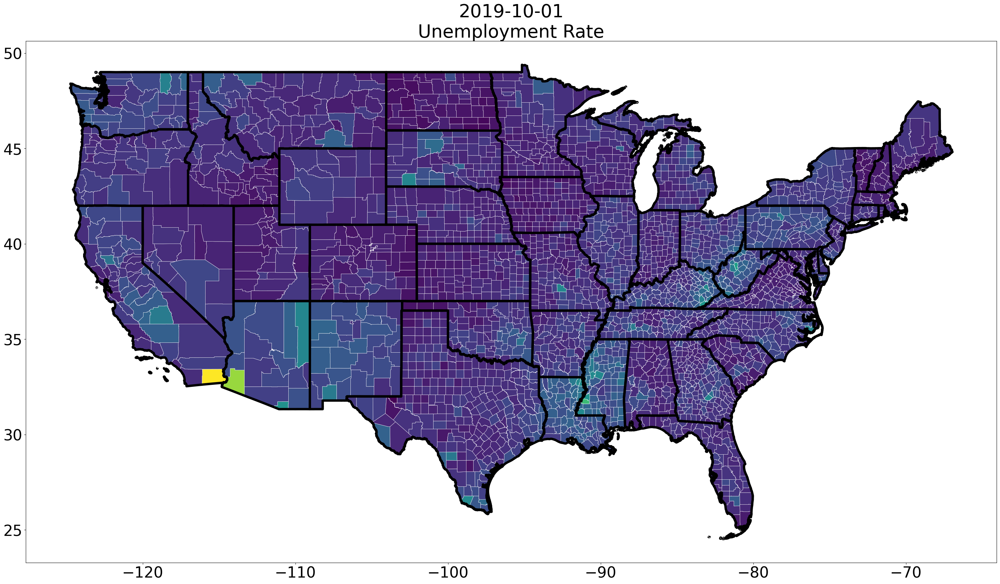

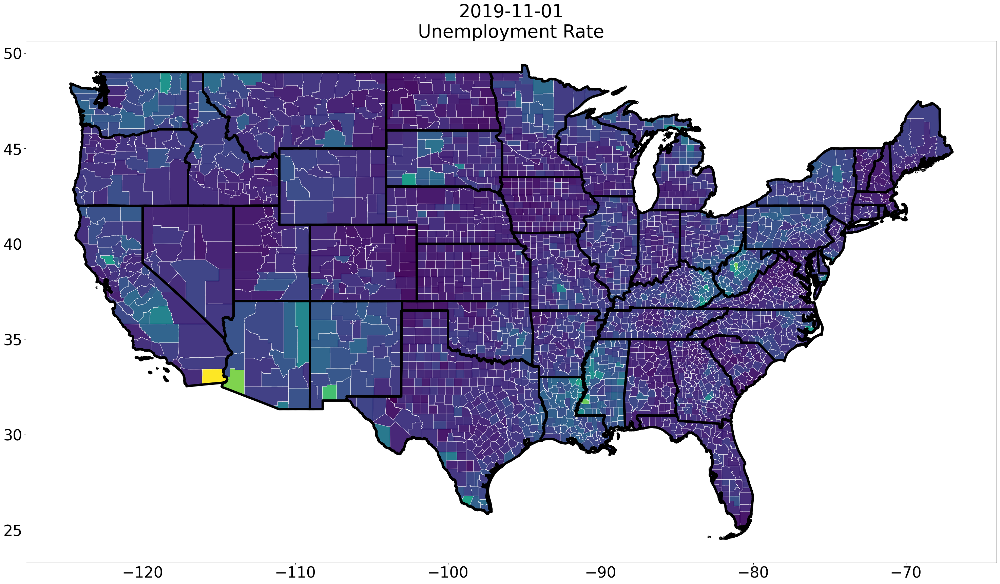

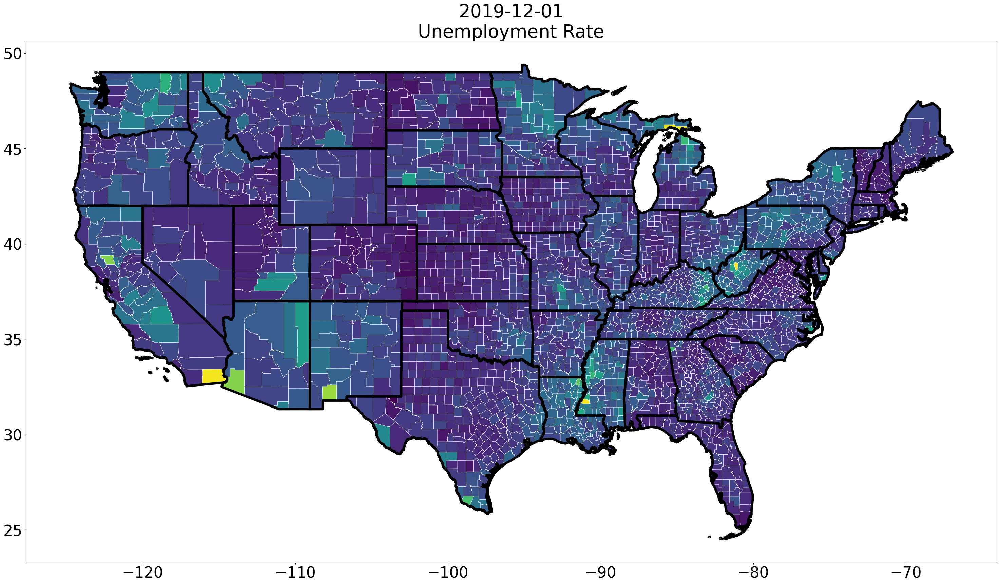

...

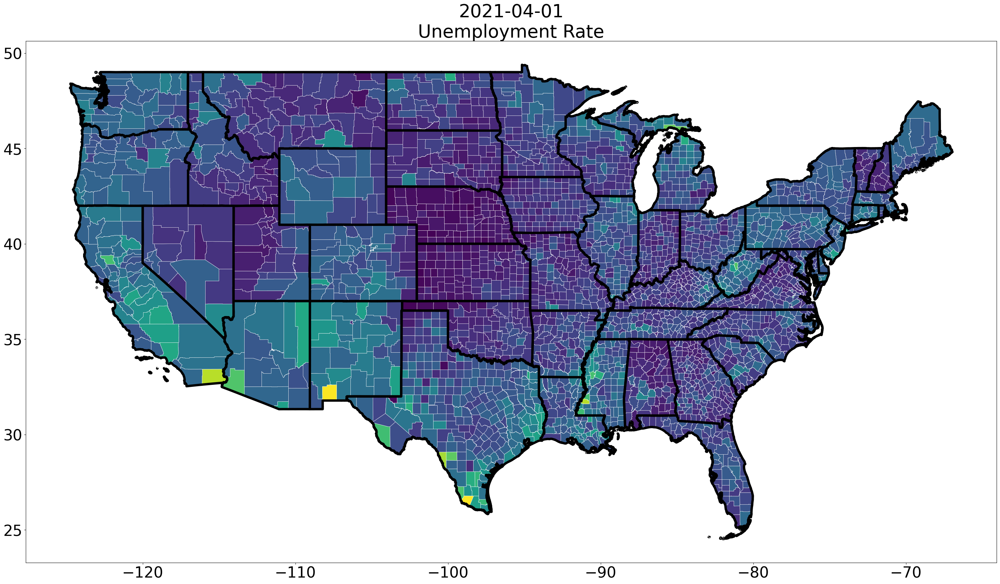

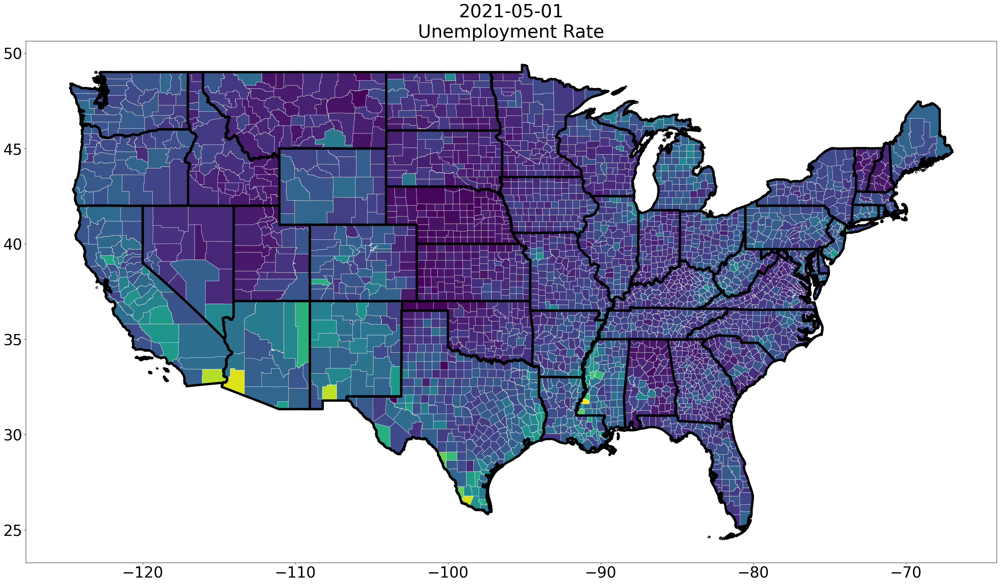

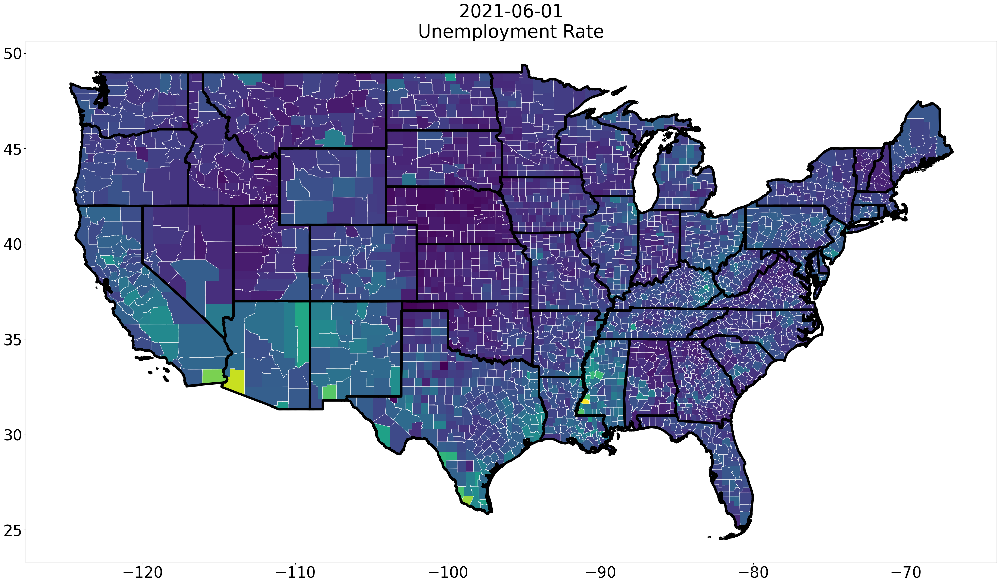

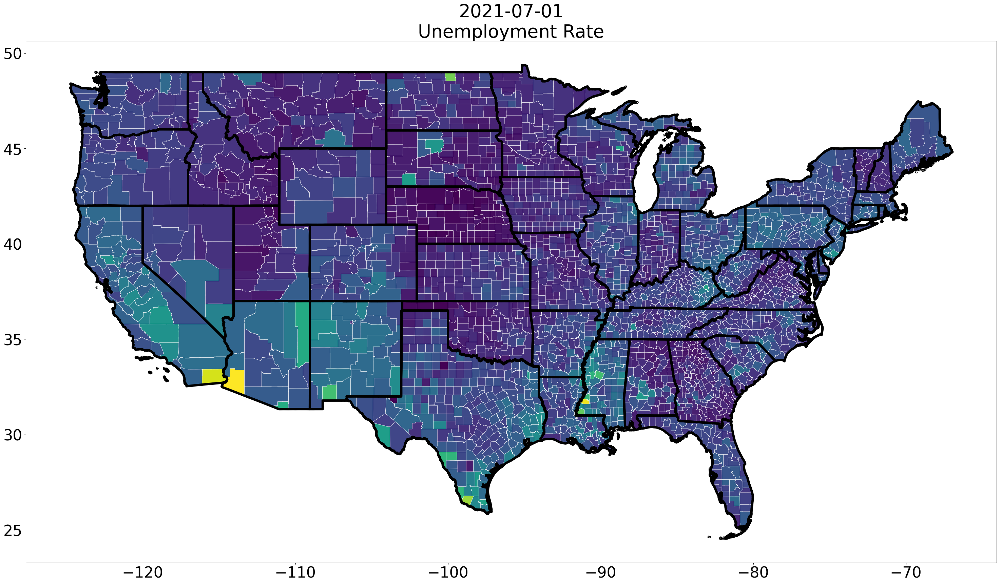

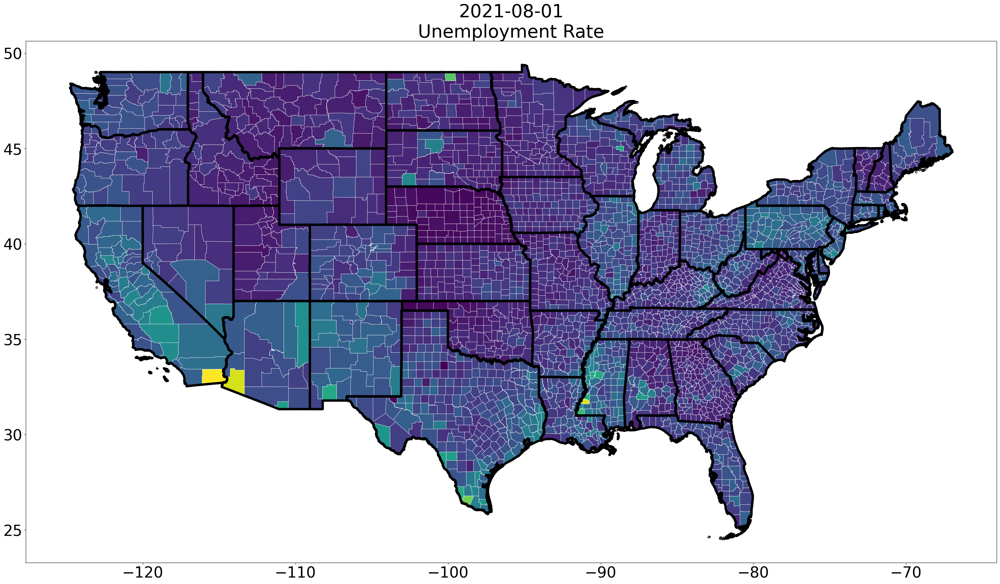

In [117]:
plt.rcParams.update({'font.size': 32})

plot_data = u_data["Unemployment Rate"].copy()
plot_data = plot_data[~plot_data["state"].isin(["Hawaii", "Alaska"])]
state_df = plot_data.dissolve(by=["state"], aggfunc = "median")
for date in dates:
    fig, ax = plt.subplots(figsize = (40,20))
    # dissolve performs groupby operation and aggregates geoids to the
    #  level grouped by

    plot_data.plot(column=date, 
                   linewidth = .5, 
                   edgecolor = "white",
                   alpha = 1, 
                   ax = ax)
    state_df.plot(color = "None", 
                  alpha = 1,
                  edgecolor = "k",
                  linewidth = 5,
                  ax = ax)
    ax.set_title(str(date)[:10] + "\nUnemployment Rate")

In [90]:
for key, df in u_data.items():
    u_data[key] = df[~df["state"].isin(["Hawaii", "Alaska"])]

In [92]:
sorted(u_data[key]["state"].unique())

['Alabama',
 'Arizona',
 'Arkansas',
 'California',
 'Colorado',
 'Connecticut',
 'Delaware',
 'District of Columbia',
 'Florida',
 'Georgia',
 'Idaho',
 'Illinois',
 'Indiana',
 'Iowa',
 'Kansas',
 'Kentucky',
 'Louisiana',
 'Maine',
 'Maryland',
 'Massachusetts',
 'Michigan',
 'Minnesota',
 'Mississippi',
 'Missouri',
 'Montana',
 'Nebraska',
 'Nevada',
 'New Hampshire',
 'New Jersey',
 'New Mexico',
 'New York',
 'North Carolina',
 'North Dakota',
 'Ohio',
 'Oklahoma',
 'Oregon',
 'Pennsylvania',
 'Rhode Island',
 'South Carolina',
 'South Dakota',
 'Tennessee',
 'Texas',
 'Utah',
 'Vermont',
 'Virginia',
 'Washington',
 'West Virginia',
 'Wisconsin',
 'Wyoming']